# **Exploratory Data Analysis for Machine Learning in Movies Dataset**
Written by Yohanes Setiawan

# Main Objective

Main objective of the analysis is prediction using regression analysis. The writer uses four types of regression models: Simple Linear Regression, Polynomial Regression, Ridge Regression, and Lasso Regression. The models are evaluated by R^2 score and Mean Absolute Error (MAE).

# Data Understanding

The dataset was taken from Kaggle entitled Flight Price Prediction (https://www.kaggle.com/shubhambathwal/flight-price-prediction). According to the website, the dataset consist of flight booking data taken from “Ease my Trip”, a flight travel between India’s top 6 metro cities. 

-	Airline: The name of the airline company is stored in the airline column. It is a categorical feature having 6 different airlines.
-	Flight: Flight stores information regarding the plane's flight code. It is a categorical feature
-	Source City: City from which the flight takes off. It is a categorical feature having 6 unique cities.
-	Departure Time: This is a derived categorical feature obtained created by grouping time periods into bins. It stores information about the departure time and have 6 unique time labels.
-	Stops: A categorical feature with 3 distinct values that stores the number of stops between the source and destination cities.
-	Arrival Time: This is a derived categorical feature created by grouping time intervals into bins. It has six distinct time labels and keeps information about the arrival time.
-	Destination City: City where the flight will land. It is a categorical feature having 6 unique cities.
-	Class: A categorical feature that contains information on seat class; it has two distinct values: Business and Economy.
-	Duration: A continuous feature that displays the overall amount of time it takes to travel between cities in hours.
-	Days Left: This is a derived characteristic that is calculated by subtracting the trip date by the booking date.
-	Price: Target variable stores information of the ticket price.


# Load Data

In [ ]:
import os
import pandas as pd
import numpy as np

In [ ]:
movies = pd.read_csv("movies.csv", sep=",")

In [ ]:
movies.head()

,MOVIES,YEAR,GENRE,RATING,ONE-LINE,STARS,VOTES,RunTime,Gross
0,Blood Red Sky,(2021),"\nAction, Horror, Thriller",6.1,\nA woman with a mysterious illness is forced ...,\n Director:\nPeter Thorwarth\n| \n Star...,"21,062",121.0,NaN
1,Masters of the Universe: Revelation,(2021– ),"\nAnimation, Action, Adventure",5.0,\nThe war for Eternia begins again in what may...,"\n \n Stars:\nChris Wood, \nSara...","17,870",25.0,NaN
2,The Walking Dead,(2010–2022),"\nDrama, Horror, Thriller",8.2,\nSheriff Deputy Rick Grimes wakes up from a c...,"\n \n Stars:\nAndrew Lincoln, \n...","885,805",44.0,NaN
3,Rick and Morty,(2013– ),"\nAnimation, Adventure, Comedy",9.2,\nAn animated series that follows the exploits...,"\n \n Stars:\nJustin Roiland, \n...","414,849",23.0,NaN
4,Army of Thieves,(2021),"\nAction, Crime, Horror",NaN,"\nA prequel, set before the events of Army of ...",\n Director:\nMatthias Schweighöfer\n| \n ...,NaN,NaN,NaN


## Dataset Information

In [ ]:
# Number of rows
print("Total rows: ", movies.shape[0]) #take the rows only

# Column names
print("Column names: ", movies.columns.tolist())

# Data types for each column
print("Datatype of each column: ")
print(movies.dtypes)

Total rows:  9999
Column names:  ['MOVIES', 'YEAR', 'GENRE', 'RATING', 'ONE-LINE', 'STARS', 'VOTES', 'RunTime', 'Gross']
Datatype of each column: 
MOVIES       object
YEAR         object
GENRE        object
RATING      float64
ONE-LINE     object
STARS        object
VOTES        object
RunTime     float64
Gross        object
dtype: object


In [ ]:
print(movies.notnull())

      MOVIES  YEAR  GENRE  RATING  ONE-LINE  STARS  VOTES  RunTime  Gross
0       True  True   True    True      True   True   True     True  False
1       True  True   True    True      True   True   True     True  False
2       True  True   True    True      True   True   True     True  False
3       True  True   True    True      True   True   True     True  False
4       True  True   True   False      True   True  False    False  False
...      ...   ...    ...     ...       ...    ...    ...      ...    ...
9994    True  True   True   False      True   True  False    False  False
9995    True  True   True   False      True   True  False    False  False
9996    True  True   True   False      True   True  False    False  False
9997    True  True   True   False      True   True  False    False  False
9998    True  True   True   False      True   True  False    False  False

[9999 rows x 9 columns]


#Data Cleaning

## Missing Values

In [ ]:
print("Non Missing Value from the Dataset for each column: ")
print(movies.notnull().sum())

Non Missing Value from the Dataset for each column: 
MOVIES      9999
YEAR        9355
GENRE       9919
RATING      8179
ONE-LINE    9999
STARS       9999
VOTES       8179
RunTime     7041
Gross        460
dtype: int64


In [ ]:
print("Missing Value from the Dataset for each column: ")
print(movies.isnull().sum())

Missing Value from the Dataset for each column: 
MOVIES         0
YEAR         644
GENRE         80
RATING      1820
ONE-LINE       0
STARS          0
VOTES       1820
RunTime     2958
Gross       9539
dtype: int64


In [ ]:
movies["RATING"].isnull()

0       False
1       False
2       False
3       False
4        True
        ...  
9994     True
9995     True
9996     True
9997     True
9998     True
Name: RATING, Length: 9999, dtype: bool

In [ ]:
movies.groupby("Gross").count()

,MOVIES,YEAR,GENRE,RATING,ONE-LINE,STARS,VOTES,RunTime
Gross,,,,,,,,
$0.00M,15,15,15,15,15,15,15,15
$0.01M,22,22,22,22,22,22,22,22
$0.02M,16,16,16,16,16,16,16,16
$0.03M,10,10,10,10,10,10,10,10
$0.04M,9,9,9,9,9,9,9,9
...,...,...,...,...,...,...,...,...
$94.90M,1,1,1,1,1,1,1,1
$95.86M,1,1,1,1,1,1,1,1
$96.52M,1,1,1,1,1,1,1,1


In [ ]:
#Saving not null "Gross" feature to another variable
mov_gross = movies[movies["Gross"].notnull()]
mov_gross.head()

,MOVIES,YEAR,GENRE,RATING,ONE-LINE,STARS,VOTES,RunTime,Gross
77,The Hitman's Bodyguard,(2017),"\nAction, Comedy, Crime",6.9,"\nThe world's top bodyguard gets a new client,...",\n Director:\nPatrick Hughes\n| \n Stars...,"205,979",118.0,$75.47M
85,Jurassic Park,(1993),"\nAction, Adventure, Sci-Fi",8.1,\nA pragmatic paleontologist visiting an almos...,\n Director:\nSteven Spielberg\n| \n Sta...,"897,444",127.0,$402.45M
95,Don't Breathe,(2016),"\nCrime, Horror, Thriller",7.1,"\nHoping to walk away with a massive fortune, ...",\n Director:\nFede Alvarez\n| \n Stars:\...,"237,601",88.0,$89.22M
111,The Lord of the Rings: The Fellowship of the Ring,(2001),"\nAction, Adventure, Drama",8.8,\nA meek Hobbit from the Shire and eight compa...,\n Director:\nPeter Jackson\n| \n Stars:...,"1,713,028",178.0,$315.54M
125,Escape Room,(I) (2019),"\nAction, Adventure, Horror",6.4,\nSix strangers find themselves in a maze of d...,\n Director:\nAdam Robitel\n| \n Stars:\...,"99,351",99.0,$57.01M


In [ ]:
#Drop Gross from main "movies" pandas
movies.drop(["Gross"], axis=1, inplace=True) #axis=1 means column indexes

In [ ]:
movies.head()

,MOVIES,YEAR,GENRE,RATING,ONE-LINE,STARS,VOTES,RunTime
0,Blood Red Sky,(2021),"\nAction, Horror, Thriller",6.1,\nA woman with a mysterious illness is forced ...,\n Director:\nPeter Thorwarth\n| \n Star...,"21,062",121.0
1,Masters of the Universe: Revelation,(2021– ),"\nAnimation, Action, Adventure",5.0,\nThe war for Eternia begins again in what may...,"\n \n Stars:\nChris Wood, \nSara...","17,870",25.0
2,The Walking Dead,(2010–2022),"\nDrama, Horror, Thriller",8.2,\nSheriff Deputy Rick Grimes wakes up from a c...,"\n \n Stars:\nAndrew Lincoln, \n...","885,805",44.0
3,Rick and Morty,(2013– ),"\nAnimation, Adventure, Comedy",9.2,\nAn animated series that follows the exploits...,"\n \n Stars:\nJustin Roiland, \n...","414,849",23.0
4,Army of Thieves,(2021),"\nAction, Crime, Horror",NaN,"\nA prequel, set before the events of Army of ...",\n Director:\nMatthias Schweighöfer\n| \n ...,NaN,NaN


In [ ]:
#Saving the null "Genre" feature to another variable
null_genre = movies[movies["GENRE"].isnull()]
null_genre.head()

,MOVIES,YEAR,GENRE,RATING,ONE-LINE,STARS,VOTES,RunTime
2124,Rodney & Sheryl,NaN,NaN,NaN,\nBased on the unbelievable true story of seri...,\n Director:\nChloe Okuno\n| \n Star:\nA...,NaN,NaN
3144,Our Man from Jersey,NaN,NaN,NaN,\nAdd a Plot\n,"\n \n Stars:\nMark Wahlberg, \nH...",NaN,NaN
3433,The Upper World,NaN,NaN,NaN,\nEsso is caught in a deadly feud and on the v...,\n \n Star:\nDaniel Kaluuya\n,NaN,NaN
3695,Kod Adi: Kulüp,(2021– ),NaN,NaN,\nAdd a Plot\n,"\n \n Stars:\nGökçe Bahadir, \nB...",NaN,NaN
4039,Oompa-Loompas,NaN,NaN,NaN,\nTV series centering on the adventures of the...,\n,NaN,NaN


In [ ]:
#Drop rows that have null GENRE from main "movies" pandas
movies = movies[movies['GENRE'].notna()]

In [ ]:
movies.head()

,MOVIES,YEAR,GENRE,RATING,ONE-LINE,STARS,VOTES,RunTime
0,Blood Red Sky,(2021),"\nAction, Horror, Thriller",6.1,\nA woman with a mysterious illness is forced ...,\n Director:\nPeter Thorwarth\n| \n Star...,"21,062",121.0
1,Masters of the Universe: Revelation,(2021– ),"\nAnimation, Action, Adventure",5.0,\nThe war for Eternia begins again in what may...,"\n \n Stars:\nChris Wood, \nSara...","17,870",25.0
2,The Walking Dead,(2010–2022),"\nDrama, Horror, Thriller",8.2,\nSheriff Deputy Rick Grimes wakes up from a c...,"\n \n Stars:\nAndrew Lincoln, \n...","885,805",44.0
3,Rick and Morty,(2013– ),"\nAnimation, Adventure, Comedy",9.2,\nAn animated series that follows the exploits...,"\n \n Stars:\nJustin Roiland, \n...","414,849",23.0
4,Army of Thieves,(2021),"\nAction, Crime, Horror",NaN,"\nA prequel, set before the events of Army of ...",\n Director:\nMatthias Schweighöfer\n| \n ...,NaN,NaN


In [ ]:
print("Updated Missing Value from the Dataset for each column: ")
print(movies.isnull().sum())

Updated Missing Value from the Dataset for each column: 
MOVIES         0
YEAR         603
GENRE          0
RATING      1751
ONE-LINE       0
STARS          0
VOTES       1751
RunTime     2887
dtype: int64


In [ ]:
#Fill the missing value in RATING with "0"
movies["RATING"] = movies["RATING"].fillna(0)

In [ ]:
print("Updated Missing Value from the Dataset for each column: ")
print(movies.isnull().sum())

Updated Missing Value from the Dataset for each column: 
MOVIES         0
YEAR         603
GENRE          0
RATING         0
ONE-LINE       0
STARS          0
VOTES       1751
RunTime     2887
dtype: int64


In [ ]:
movies['RATING'].head(40)

0     6.1
1     5.0
2     8.2
3     9.2
4     0.0
5     7.6
6     6.8
7     8.6
8     7.9
9     7.4
10    6.0
11    8.1
12    6.2
13    5.4
14    8.0
15    7.5
16    9.4
17    8.1
18    8.3
19    8.7
20    6.8
21    8.9
22    7.6
23    8.8
24    0.0
25    5.0
26    8.5
27    8.8
28    8.4
29    8.0
30    6.7
31    8.2
32    8.4
33    7.7
34    8.4
35    8.4
36    7.7
37    8.2
38    8.7
39    9.0
Name: RATING, dtype: float64

In [ ]:
movies.loc[movies["VOTES"].isnull()]

,MOVIES,YEAR,GENRE,RATING,ONE-LINE,STARS,VOTES,RunTime
4,Army of Thieves,(2021),"\nAction, Crime, Horror",0.0,"\nA prequel, set before the events of Army of ...",\n Director:\nMatthias Schweighöfer\n| \n ...,NaN,NaN
24,He-Man and the Masters of the Universe,(2021– ),"\nAnimation, Action, Adventure",0.0,\nEternia's Prince Adam discovers the power of...,\n,NaN,NaN
214,Sing 2,(2021),"\nAnimation, Adventure, Comedy",0.0,\nBuster Moon and his friends must persuade re...,\n Director:\nGarth Jennings\n| \n Stars...,NaN,NaN
217,Knives Out 2,(2022),"\nComedy, Crime, Drama",0.0,\nPlot unknown. Sequel to the 2019 film 'Knive...,\n Director:\nRian Johnson\n| \n Stars:\...,NaN,NaN
222,Don't Look Up,(2021),\nComedy,0.0,"\nThe story of two low-level astronomers, who ...",\n Director:\nAdam McKay\n| \n Stars:\nT...,NaN,145.0
...,...,...,...,...,...,...,...,...
9994,The Imperfects,(2021– ),"\nAdventure, Drama, Fantasy",0.0,\nAdd a Plot\n,\n \n Stars:\nMorgan Taylor Camp...,NaN,NaN
9995,Arcane,(2021– ),"\nAnimation, Action, Adventure",0.0,\nAdd a Plot\n,\n,NaN,NaN
9996,Heart of Invictus,(2022– ),"\nDocumentary, Sport",0.0,\nAdd a Plot\n,\n Director:\nOrlando von Einsiedel\n| \n ...,NaN,NaN
9997,The Imperfects,(2021– ),"\nAdventure, Drama, Fantasy",0.0,\nAdd a Plot\n,\n Director:\nJovanka Vuckovic\n| \n Sta...,NaN,NaN


In [ ]:
movies.loc[movies["VOTES"].isnull()].isnull().sum()

MOVIES         0
YEAR         603
GENRE          0
RATING         0
ONE-LINE       0
STARS          0
VOTES       1751
RunTime     1498
dtype: int64

In [ ]:
movies.loc[movies["RunTime"].isnull()]

,MOVIES,YEAR,GENRE,RATING,ONE-LINE,STARS,VOTES,RunTime
4,Army of Thieves,(2021),"\nAction, Crime, Horror",0.0,"\nA prequel, set before the events of Army of ...",\n Director:\nMatthias Schweighöfer\n| \n ...,NaN,NaN
13,Sex/Life,(2021– ),"\nComedy, Drama, Romance",5.4,\nA suburban mother of two takes a fantasy-cha...,"\n \n Stars:\nSarah Shahi, \nMik...","12,172",NaN
24,He-Man and the Masters of the Universe,(2021– ),"\nAnimation, Action, Adventure",0.0,\nEternia's Prince Adam discovers the power of...,\n,NaN,NaN
48,Sweet Tooth,(2021– ),"\nAction, Adventure, Drama",7.9,\nA boy who is half human and half deer surviv...,"\n \n Stars:\nNonso Anozie, \nCh...","37,142",NaN
76,Shadow and Bone,(2021– ),"\nAction, Adventure, Drama",7.7,\nDark forces conspire against orphan mapmaker...,"\n \n Stars:\nJessie Mei Li, \nB...","60,283",NaN
...,...,...,...,...,...,...,...,...
9994,The Imperfects,(2021– ),"\nAdventure, Drama, Fantasy",0.0,\nAdd a Plot\n,\n \n Stars:\nMorgan Taylor Camp...,NaN,NaN
9995,Arcane,(2021– ),"\nAnimation, Action, Adventure",0.0,\nAdd a Plot\n,\n,NaN,NaN
9996,Heart of Invictus,(2022– ),"\nDocumentary, Sport",0.0,\nAdd a Plot\n,\n Director:\nOrlando von Einsiedel\n| \n ...,NaN,NaN
9997,The Imperfects,(2021– ),"\nAdventure, Drama, Fantasy",0.0,\nAdd a Plot\n,\n Director:\nJovanka Vuckovic\n| \n Sta...,NaN,NaN


In [ ]:
movies.loc[movies["RunTime"].isnull()].isnull().sum()

MOVIES         0
YEAR         576
GENRE          0
RATING         0
ONE-LINE       0
STARS          0
VOTES       1498
RunTime     2887
dtype: int64

In [ ]:
#Fill the missing value in RATING with "0"
movies[["RATING","VOTES","RunTime"]] = movies[["RATING","VOTES","RunTime"]].fillna(0)

In [ ]:
print("Updated Missing Value from the Dataset for each column: ")
print(movies.isnull().sum())

Updated Missing Value from the Dataset for each column: 
MOVIES        0
YEAR        603
GENRE         0
RATING        0
ONE-LINE      0
STARS         0
VOTES         0
RunTime       0
dtype: int64


In [ ]:
#Fill the missing value in RATING with "0"
movies["YEAR"] = movies["YEAR"].fillna("Unknown")

In [ ]:
print("Updated Missing Value from the Dataset for each column: ")
print(movies.isnull().sum())

Updated Missing Value from the Dataset for each column: 
MOVIES      0
YEAR        0
GENRE       0
RATING      0
ONE-LINE    0
STARS       0
VOTES       0
RunTime     0
dtype: int64


In [ ]:
movies.head(20)

,MOVIES,YEAR,GENRE,RATING,ONE-LINE,STARS,VOTES,RunTime
0,Blood Red Sky,(2021),"\nAction, Horror, Thriller",6.1,\nA woman with a mysterious illness is forced ...,\n Director:\nPeter Thorwarth\n| \n Star...,"21,062",121.0
1,Masters of the Universe: Revelation,(2021– ),"\nAnimation, Action, Adventure",5.0,\nThe war for Eternia begins again in what may...,"\n \n Stars:\nChris Wood, \nSara...","17,870",25.0
2,The Walking Dead,(2010–2022),"\nDrama, Horror, Thriller",8.2,\nSheriff Deputy Rick Grimes wakes up from a c...,"\n \n Stars:\nAndrew Lincoln, \n...","885,805",44.0
3,Rick and Morty,(2013– ),"\nAnimation, Adventure, Comedy",9.2,\nAn animated series that follows the exploits...,"\n \n Stars:\nJustin Roiland, \n...","414,849",23.0
4,Army of Thieves,(2021),"\nAction, Crime, Horror",0.0,"\nA prequel, set before the events of Army of ...",\n Director:\nMatthias Schweighöfer\n| \n ...,0,0.0
5,Outer Banks,(2020– ),"\nAction, Crime, Drama",7.6,\nA group of teenagers from the wrong side of ...,"\n \n Stars:\nChase Stokes, \nMa...","25,858",50.0
6,The Last Letter from Your Lover,(2021),"\nDrama, Romance",6.8,\nA pair of interwoven stories set in the past...,\n Director:\nAugustine Frizzell\n| \n S...,"5,283",110.0
7,Dexter,(2006–2013),"\nCrime, Drama, Mystery",8.6,"\nBy day, mild-mannered Dexter is a blood-spat...","\n \n Stars:\nMichael C. Hall, \...","665,387",53.0
8,Never Have I Ever,(2020– ),\nComedy,7.9,\nThe complicated life of a modern-day first g...,\n \n Stars:\nMaitreyi Ramakrish...,"34,530",30.0
9,Virgin River,(2019– ),"\nDrama, Romance",7.4,"\nSeeking a fresh start, nurse practitioner Me...",\n \n Stars:\nAlexandra Breckenr...,"27,279",44.0


In [ ]:
movies.tail(20)

,MOVIES,YEAR,GENRE,RATING,ONE-LINE,STARS,VOTES,RunTime
9979,Never Have I Ever,(2020– ),\nComedy,8.8,\nAs Paxton's mixed messages have Devi questio...,\n Director:\nLang Fisher\n| \n Stars:\n...,433,0.0
9980,1899,(2022– ),"\nDrama, History, Horror",0.0,\nAdd a Plot\n,\n Director:\nBaran bo Odar\n,0,0.0
9981,1899,(2022– ),"\nDrama, History, Horror",0.0,\nAdd a Plot\n,\n Director:\nBaran bo Odar\n,0,0.0
9982,1899,(2022– ),"\nDrama, History, Horror",0.0,\nAdd a Plot\n,\n Director:\nBaran bo Odar\n,0,0.0
9983,The Last Kingdom,(2015– ),"\nAction, Drama, History",0.0,\nAdd a Plot\n,\n Director:\nPaul Wilmshurst\n| \n Star...,0,0.0
9984,The Last Kingdom,(2015– ),"\nAction, Drama, History",0.0,\nAdd a Plot\n,\n Director:\nPaul Wilmshurst\n| \n Star...,0,0.0
9985,The Last Kingdom,(2015– ),"\nAction, Drama, History",0.0,\nAdd a Plot\n,\n Director:\nPaul Wilmshurst\n| \n Star...,0,0.0
9986,The Last Kingdom,(2015– ),"\nAction, Drama, History",0.0,\nAdd a Plot\n,\n,0,0.0
9987,The Last Kingdom,(2015– ),"\nAction, Drama, History",0.0,\nAdd a Plot\n,\n Director:\nAnthony Philipson\n,0,0.0
9988,The Last Kingdom,(2015– ),"\nAction, Drama, History",0.0,\nAdd a Plot\n,\n Director:\nAnthony Philipson\n,0,0.0


## Checking Duplicated Data

In [ ]:
print("Duplicated data: ")
movies.duplicated().sum()

Duplicated data: 


429

In [ ]:
movies.drop_duplicates(inplace = True)

In [ ]:
print("Duplicated data: ")
movies.duplicated().sum()

Duplicated data: 


0

In [ ]:
movies.head()

,MOVIES,YEAR,GENRE,RATING,ONE-LINE,STARS,VOTES,RunTime
0,Blood Red Sky,(2021),"\nAction, Horror, Thriller",6.1,\nA woman with a mysterious illness is forced ...,\n Director:\nPeter Thorwarth\n| \n Star...,"21,062",121.0
1,Masters of the Universe: Revelation,(2021– ),"\nAnimation, Action, Adventure",5.0,\nThe war for Eternia begins again in what may...,"\n \n Stars:\nChris Wood, \nSara...","17,870",25.0
2,The Walking Dead,(2010–2022),"\nDrama, Horror, Thriller",8.2,\nSheriff Deputy Rick Grimes wakes up from a c...,"\n \n Stars:\nAndrew Lincoln, \n...","885,805",44.0
3,Rick and Morty,(2013– ),"\nAnimation, Adventure, Comedy",9.2,\nAn animated series that follows the exploits...,"\n \n Stars:\nJustin Roiland, \n...","414,849",23.0
4,Army of Thieves,(2021),"\nAction, Crime, Horror",0.0,"\nA prequel, set before the events of Army of ...",\n Director:\nMatthias Schweighöfer\n| \n ...,0,0.0


In [ ]:
print("Updated Data after Handling Missing and Duplicated Data")
# Number of rows
print("Total rows: ", movies.shape[0]) #take the rows only

# Column names
print("Column names: ", movies.columns.tolist())

# Data types for each column
print("Datatype of each column: ")
print(movies.dtypes)
print("Updated Missing Value and Duplicated Data from the Dataset for each column: ")
print(movies.isnull().sum())
print("Duplicated data: ", movies.duplicated().sum())

Updated Data after Handling Missing and Duplicated Data
Total rows:  9490
Column names:  ['MOVIES', 'YEAR', 'GENRE', 'RATING', 'ONE-LINE', 'STARS', 'VOTES', 'RunTime']
Datatype of each column: 
MOVIES       object
YEAR         object
GENRE        object
RATING      float64
ONE-LINE     object
STARS        object
VOTES        object
RunTime     float64
dtype: object
Updated Missing Value and Duplicated Data from the Dataset for each column: 
MOVIES      0
YEAR        0
GENRE       0
RATING      0
ONE-LINE    0
STARS       0
VOTES       0
RunTime     0
dtype: int64
Duplicated data:  0


## Feature Engineering

In [ ]:
movies.groupby("GENRE")["MOVIES"].count()

GENRE
\nAction                                      36
\nAction, Adventure                            5
\nAction, Adventure, Biography                 4
\nAction, Adventure, Comedy                   75
\nAction, Adventure, Crime                    56
                                              ..
\nTalk-Show, Sport                             2
\nThriller                                    65
\nThriller, Mystery                            1
\nWar                                          1
\nWestern                                      6
Name: MOVIES, Length: 510, dtype: int64

In [ ]:
# The str method maps the following function to each entry as a string
movies['GENRE'] = movies.GENRE.str.replace('\n', '')
movies["STARS"] = movies.STARS.str.replace('\n', '')
movies["ONE-LINE"] = movies["ONE-LINE"].str.replace('\n', '')

In [ ]:
movies.groupby("GENRE")["MOVIES"].count()

GENRE
Action                                      36
Action, Adventure                            5
Action, Adventure, Biography                 4
Action, Adventure, Comedy                   75
Action, Adventure, Crime                    56
                                            ..
Talk-Show, Sport                             2
Thriller                                    65
Thriller, Mystery                            1
War                                          1
Western                                      6
Name: MOVIES, Length: 510, dtype: int64

In [ ]:
movies.head()

,MOVIES,YEAR,GENRE,RATING,ONE-LINE,STARS,VOTES,RunTime
0,Blood Red Sky,(2021),"Action, Horror, Thriller",6.1,A woman with a mysterious illness is forced in...,Director:Peter Thorwarth| Stars:Peri B...,"21,062",121.0
1,Masters of the Universe: Revelation,(2021– ),"Animation, Action, Adventure",5.0,The war for Eternia begins again in what may b...,"Stars:Chris Wood, Sarah Michel...","17,870",25.0
2,The Walking Dead,(2010–2022),"Drama, Horror, Thriller",8.2,Sheriff Deputy Rick Grimes wakes up from a com...,"Stars:Andrew Lincoln, Norman R...","885,805",44.0
3,Rick and Morty,(2013– ),"Animation, Adventure, Comedy",9.2,An animated series that follows the exploits o...,"Stars:Justin Roiland, Chris Pa...","414,849",23.0
4,Army of Thieves,(2021),"Action, Crime, Horror",0.0,"A prequel, set before the events of Army of th...",Director:Matthias Schweighöfer| Stars:...,0,0.0


In [ ]:
genre = movies["GENRE"].value_counts()

In [ ]:
genre.head(10)

Comedy                                      837
Animation, Action, Adventure                663
Drama                                       546
Documentary                                 495
Crime, Drama, Mystery                       328
Comedy, Drama                               275
Action, Adventure, Drama                    216
Drama, Romance                              214
Comedy, Drama, Romance                      191
Action, Crime, Drama                        185
Name: GENRE, dtype: int64

In [ ]:
genre2 = movies.GENRE.str.split(',')

In [ ]:
genre2

0           [Action,  Horror,  Thriller            ]
1       [Animation,  Action,  Adventure            ]
2            [Drama,  Horror,  Thriller            ]
3       [Animation,  Adventure,  Comedy            ]
4              [Action,  Crime,  Horror            ]
                            ...                     
9993                  [Drama,  Thriller            ]
9995    [Animation,  Action,  Adventure            ]
9996               [Documentary,  Sport            ]
9997       [Adventure,  Drama,  Fantasy            ]
9998       [Adventure,  Drama,  Fantasy            ]
Name: GENRE, Length: 9490, dtype: object

In [ ]:
genre2[0]

['Action', ' Horror', ' Thriller            ']

In [ ]:
genre2[0][2]

' Thriller            '

In [ ]:
movies.tail()

,MOVIES,YEAR,GENRE,RATING,ONE-LINE,STARS,VOTES,RunTime
9993,Totenfrau,(2022– ),"Drama, Thriller",0.0,Add a Plot,Director:Nicolai Rohde| Stars:Felix Kl...,0,0.0
9995,Arcane,(2021– ),"Animation, Action, Adventure",0.0,Add a Plot,,0,0.0
9996,Heart of Invictus,(2022– ),"Documentary, Sport",0.0,Add a Plot,Director:Orlando von Einsiedel| Star:P...,0,0.0
9997,The Imperfects,(2021– ),"Adventure, Drama, Fantasy",0.0,Add a Plot,Director:Jovanka Vuckovic| Stars:Morga...,0,0.0
9998,The Imperfects,(2021– ),"Adventure, Drama, Fantasy",0.0,Add a Plot,Director:Jovanka Vuckovic| Stars:Morga...,0,0.0


In [ ]:
movies.reset_index(drop=True, inplace=True)

In [ ]:
movies.tail()

,MOVIES,YEAR,GENRE,RATING,ONE-LINE,STARS,VOTES,RunTime
9485,Totenfrau,(2022– ),"Drama, Thriller",0.0,Add a Plot,Director:Nicolai Rohde| Stars:Felix Kl...,0,0.0
9486,Arcane,(2021– ),"Animation, Action, Adventure",0.0,Add a Plot,,0,0.0
9487,Heart of Invictus,(2022– ),"Documentary, Sport",0.0,Add a Plot,Director:Orlando von Einsiedel| Star:P...,0,0.0
9488,The Imperfects,(2021– ),"Adventure, Drama, Fantasy",0.0,Add a Plot,Director:Jovanka Vuckovic| Stars:Morga...,0,0.0
9489,The Imperfects,(2021– ),"Adventure, Drama, Fantasy",0.0,Add a Plot,Director:Jovanka Vuckovic| Stars:Morga...,0,0.0


In [ ]:
movies.head(50)

,MOVIES,YEAR,GENRE,RATING,ONE-LINE,STARS,VOTES,RunTime
0,Blood Red Sky,(2021),"Action, Horror, Thriller",6.1,A woman with a mysterious illness is forced in...,Director:Peter Thorwarth| Stars:Peri B...,"21,062",121.0
1,Masters of the Universe: Revelation,(2021– ),"Animation, Action, Adventure",5.0,The war for Eternia begins again in what may b...,"Stars:Chris Wood, Sarah Michel...","17,870",25.0
2,The Walking Dead,(2010–2022),"Drama, Horror, Thriller",8.2,Sheriff Deputy Rick Grimes wakes up from a com...,"Stars:Andrew Lincoln, Norman R...","885,805",44.0
3,Rick and Morty,(2013– ),"Animation, Adventure, Comedy",9.2,An animated series that follows the exploits o...,"Stars:Justin Roiland, Chris Pa...","414,849",23.0
4,Army of Thieves,(2021),"Action, Crime, Horror",0.0,"A prequel, set before the events of Army of th...",Director:Matthias Schweighöfer| Stars:...,0,0.0
5,Outer Banks,(2020– ),"Action, Crime, Drama",7.6,A group of teenagers from the wrong side of th...,"Stars:Chase Stokes, Madelyn Cl...","25,858",50.0
6,The Last Letter from Your Lover,(2021),"Drama, Romance",6.8,A pair of interwoven stories set in the past a...,Director:Augustine Frizzell| Stars:Sha...,"5,283",110.0
7,Dexter,(2006–2013),"Crime, Drama, Mystery",8.6,"By day, mild-mannered Dexter is a blood-spatte...","Stars:Michael C. Hall, Jennife...","665,387",53.0
8,Never Have I Ever,(2020– ),Comedy,7.9,The complicated life of a modern-day first gen...,"Stars:Maitreyi Ramakrishnan, P...","34,530",30.0
9,Virgin River,(2019– ),"Drama, Romance",7.4,"Seeking a fresh start, nurse practitioner Meli...","Stars:Alexandra Breckenridge, ...","27,279",44.0


In [ ]:
genre3 = movies.GENRE.str.replace(" ", "")

In [ ]:
genre3

0           Action,Horror,Thriller
1       Animation,Action,Adventure
2            Drama,Horror,Thriller
3       Animation,Adventure,Comedy
4              Action,Crime,Horror
                   ...            
9485                Drama,Thriller
9486    Animation,Action,Adventure
9487             Documentary,Sport
9488       Adventure,Drama,Fantasy
9489       Adventure,Drama,Fantasy
Name: GENRE, Length: 9490, dtype: object

In [ ]:
genre3 = genre3.str.split(',')

In [ ]:
genre3

0           [Action, Horror, Thriller]
1       [Animation, Action, Adventure]
2            [Drama, Horror, Thriller]
3       [Animation, Adventure, Comedy]
4              [Action, Crime, Horror]
                     ...              
9485                 [Drama, Thriller]
9486    [Animation, Action, Adventure]
9487              [Documentary, Sport]
9488       [Adventure, Drama, Fantasy]
9489       [Adventure, Drama, Fantasy]
Name: GENRE, Length: 9490, dtype: object

In [ ]:
genre3.head()

0        [Action, Horror, Thriller]
1    [Animation, Action, Adventure]
2         [Drama, Horror, Thriller]
3    [Animation, Adventure, Comedy]
4           [Action, Crime, Horror]
Name: GENRE, dtype: object

In [ ]:
genre3[0][1]

'Horror'

In [ ]:
#remove the space
movies["GENRE"] = movies.GENRE.str.replace(" ", "")
movies.head()

,MOVIES,YEAR,GENRE,RATING,ONE-LINE,STARS,VOTES,RunTime
0,Blood Red Sky,(2021),"Action,Horror,Thriller",6.1,A woman with a mysterious illness is forced in...,Director:Peter Thorwarth| Stars:Peri B...,"21,062",121.0
1,Masters of the Universe: Revelation,(2021– ),"Animation,Action,Adventure",5.0,The war for Eternia begins again in what may b...,"Stars:Chris Wood, Sarah Michel...","17,870",25.0
2,The Walking Dead,(2010–2022),"Drama,Horror,Thriller",8.2,Sheriff Deputy Rick Grimes wakes up from a com...,"Stars:Andrew Lincoln, Norman R...","885,805",44.0
3,Rick and Morty,(2013– ),"Animation,Adventure,Comedy",9.2,An animated series that follows the exploits o...,"Stars:Justin Roiland, Chris Pa...","414,849",23.0
4,Army of Thieves,(2021),"Action,Crime,Horror",0.0,"A prequel, set before the events of Army of th...",Director:Matthias Schweighöfer| Stars:...,0,0.0


In [ ]:
movies["GENRE"] = movies.GENRE.str.split(',')
movies.head()

,MOVIES,YEAR,GENRE,RATING,ONE-LINE,STARS,VOTES,RunTime
0,Blood Red Sky,(2021),"[Action, Horror, Thriller]",6.1,A woman with a mysterious illness is forced in...,Director:Peter Thorwarth| Stars:Peri B...,"21,062",121.0
1,Masters of the Universe: Revelation,(2021– ),"[Animation, Action, Adventure]",5.0,The war for Eternia begins again in what may b...,"Stars:Chris Wood, Sarah Michel...","17,870",25.0
2,The Walking Dead,(2010–2022),"[Drama, Horror, Thriller]",8.2,Sheriff Deputy Rick Grimes wakes up from a com...,"Stars:Andrew Lincoln, Norman R...","885,805",44.0
3,Rick and Morty,(2013– ),"[Animation, Adventure, Comedy]",9.2,An animated series that follows the exploits o...,"Stars:Justin Roiland, Chris Pa...","414,849",23.0
4,Army of Thieves,(2021),"[Action, Crime, Horror]",0.0,"A prequel, set before the events of Army of th...",Director:Matthias Schweighöfer| Stars:...,0,0.0


In [ ]:
df = movies.copy()

In [ ]:
df.head()

,MOVIES,YEAR,GENRE,RATING,ONE-LINE,STARS,VOTES,RunTime
0,Blood Red Sky,(2021),"[Action, Horror, Thriller]",6.1,A woman with a mysterious illness is forced in...,Director:Peter Thorwarth| Stars:Peri B...,"21,062",121.0
1,Masters of the Universe: Revelation,(2021– ),"[Animation, Action, Adventure]",5.0,The war for Eternia begins again in what may b...,"Stars:Chris Wood, Sarah Michel...","17,870",25.0
2,The Walking Dead,(2010–2022),"[Drama, Horror, Thriller]",8.2,Sheriff Deputy Rick Grimes wakes up from a com...,"Stars:Andrew Lincoln, Norman R...","885,805",44.0
3,Rick and Morty,(2013– ),"[Animation, Adventure, Comedy]",9.2,An animated series that follows the exploits o...,"Stars:Justin Roiland, Chris Pa...","414,849",23.0
4,Army of Thieves,(2021),"[Action, Crime, Horror]",0.0,"A prequel, set before the events of Army of th...",Director:Matthias Schweighöfer| Stars:...,0,0.0


In [ ]:
#One Hot Encoding
#Source: https://stackoverflow.com/questions/45312377/how-to-one-hot-encode-from-a-pandas-column-containing-a-list
from sklearn.preprocessing import MultiLabelBinarizer

mlb = MultiLabelBinarizer(sparse_output=True)

df = df.join(
            pd.DataFrame.sparse.from_spmatrix(
                mlb.fit_transform(df.pop('GENRE')),
                index=df.index,
                columns=mlb.classes_))

In [ ]:
df.head()

,MOVIES,YEAR,RATING,ONE-LINE,STARS,VOTES,RunTime,Action,Adventure,Animation,...,News,Reality-TV,Romance,Sci-Fi,Short,Sport,Talk-Show,Thriller,War,Western
0,Blood Red Sky,(2021),6.1,A woman with a mysterious illness is forced in...,Director:Peter Thorwarth| Stars:Peri B...,"21,062",121.0,1,0,0,...,0,0,0,0,0,0,0,1,0,0
1,Masters of the Universe: Revelation,(2021– ),5.0,The war for Eternia begins again in what may b...,"Stars:Chris Wood, Sarah Michel...","17,870",25.0,1,1,1,...,0,0,0,0,0,0,0,0,0,0
2,The Walking Dead,(2010–2022),8.2,Sheriff Deputy Rick Grimes wakes up from a com...,"Stars:Andrew Lincoln, Norman R...","885,805",44.0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
3,Rick and Morty,(2013– ),9.2,An animated series that follows the exploits o...,"Stars:Justin Roiland, Chris Pa...","414,849",23.0,0,1,1,...,0,0,0,0,0,0,0,0,0,0
4,Army of Thieves,(2021),0.0,"A prequel, set before the events of Army of th...",Director:Matthias Schweighöfer| Stars:...,0,0.0,1,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
movies.head()

,MOVIES,YEAR,GENRE,RATING,ONE-LINE,STARS,VOTES,RunTime
0,Blood Red Sky,(2021),"[Action, Horror, Thriller]",6.1,A woman with a mysterious illness is forced in...,Director:Peter Thorwarth| Stars:Peri B...,"21,062",121.0
1,Masters of the Universe: Revelation,(2021– ),"[Animation, Action, Adventure]",5.0,The war for Eternia begins again in what may b...,"Stars:Chris Wood, Sarah Michel...","17,870",25.0
2,The Walking Dead,(2010–2022),"[Drama, Horror, Thriller]",8.2,Sheriff Deputy Rick Grimes wakes up from a com...,"Stars:Andrew Lincoln, Norman R...","885,805",44.0
3,Rick and Morty,(2013– ),"[Animation, Adventure, Comedy]",9.2,An animated series that follows the exploits o...,"Stars:Justin Roiland, Chris Pa...","414,849",23.0
4,Army of Thieves,(2021),"[Action, Crime, Horror]",0.0,"A prequel, set before the events of Army of th...",Director:Matthias Schweighöfer| Stars:...,0,0.0


In [ ]:
movies.head()

,MOVIES,YEAR,GENRE,RATING,ONE-LINE,STARS,VOTES,RunTime
0,Blood Red Sky,(2021),"[Action, Horror, Thriller]",6.1,A woman with a mysterious illness is forced in...,Director:Peter Thorwarth| Stars:Peri B...,"21,062",121.0
1,Masters of the Universe: Revelation,(2021– ),"[Animation, Action, Adventure]",5.0,The war for Eternia begins again in what may b...,"Stars:Chris Wood, Sarah Michel...","17,870",25.0
2,The Walking Dead,(2010–2022),"[Drama, Horror, Thriller]",8.2,Sheriff Deputy Rick Grimes wakes up from a com...,"Stars:Andrew Lincoln, Norman R...","885,805",44.0
3,Rick and Morty,(2013– ),"[Animation, Adventure, Comedy]",9.2,An animated series that follows the exploits o...,"Stars:Justin Roiland, Chris Pa...","414,849",23.0
4,Army of Thieves,(2021),"[Action, Crime, Horror]",0.0,"A prequel, set before the events of Army of th...",Director:Matthias Schweighöfer| Stars:...,0,0.0


In [ ]:
df["STARS"] = df.STARS.str.replace('\n', '')
df["ONE-LINE"] = df["ONE-LINE"].str.replace('\n', '')

In [ ]:
df.head()

,MOVIES,YEAR,RATING,ONE-LINE,STARS,VOTES,RunTime,Action,Adventure,Animation,...,News,Reality-TV,Romance,Sci-Fi,Short,Sport,Talk-Show,Thriller,War,Western
0,Blood Red Sky,(2021),6.1,A woman with a mysterious illness is forced in...,Director:Peter Thorwarth| Stars:Peri B...,"21,062",121.0,1,0,0,...,0,0,0,0,0,0,0,1,0,0
1,Masters of the Universe: Revelation,(2021– ),5.0,The war for Eternia begins again in what may b...,"Stars:Chris Wood, Sarah Michel...","17,870",25.0,1,1,1,...,0,0,0,0,0,0,0,0,0,0
2,The Walking Dead,(2010–2022),8.2,Sheriff Deputy Rick Grimes wakes up from a com...,"Stars:Andrew Lincoln, Norman R...","885,805",44.0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
3,Rick and Morty,(2013– ),9.2,An animated series that follows the exploits o...,"Stars:Justin Roiland, Chris Pa...","414,849",23.0,0,1,1,...,0,0,0,0,0,0,0,0,0,0
4,Army of Thieves,(2021),0.0,"A prequel, set before the events of Army of th...",Director:Matthias Schweighöfer| Stars:...,0,0.0,1,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
# Number of rows
print("DATA DESCRIPTION AFTER FEATURE ENGINEERING")
print("Total rows: ", df.shape[0]) #take the rows only

# Column names
print("Column names: ", df.columns.tolist())

# Data types for each column
print("Datatype of each column: ")
print(df.dtypes)

DATA DESCRIPTION AFTER FEATURE ENGINEERING
Total rows:  9490
Column names:  ['MOVIES', 'YEAR', 'RATING', 'ONE-LINE', 'STARS', 'VOTES', 'RunTime', 'Action', 'Adventure', 'Animation', 'Biography', 'Comedy', 'Crime', 'Documentary', 'Drama', 'Family', 'Fantasy', 'Film-Noir', 'Game-Show', 'History', 'Horror', 'Music', 'Musical', 'Mystery', 'News', 'Reality-TV', 'Romance', 'Sci-Fi', 'Short', 'Sport', 'Talk-Show', 'Thriller', 'War', 'Western']
Datatype of each column: 
MOVIES                   object
YEAR                     object
RATING                  float64
ONE-LINE                 object
STARS                    object
VOTES                    object
RunTime                 float64
Action         Sparse[int32, 0]
Adventure      Sparse[int32, 0]
Animation      Sparse[int32, 0]
Biography      Sparse[int32, 0]
Comedy         Sparse[int32, 0]
Crime          Sparse[int32, 0]
Documentary    Sparse[int32, 0]
Drama          Sparse[int32, 0]
Family         Sparse[int32, 0]
Fantasy        Sparse

In [ ]:
tes_list =[1, 2]

In [ ]:
df["Action"].sum()

2110

In [ ]:
df.iloc[:, 7:].head()

,Action,Adventure,Animation,Biography,Comedy,Crime,Documentary,Drama,Family,Fantasy,...,News,Reality-TV,Romance,Sci-Fi,Short,Sport,Talk-Show,Thriller,War,Western
0,1,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
1,1,1,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,1,0,0,...,0,0,0,0,0,0,0,1,0,0
3,0,1,1,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,1,0,0,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
df.iloc[:, 7:].sum()

Action         2110
Adventure      1588
Animation      1584
Biography       311
Comedy         2736
Crime          1519
Documentary    1221
Drama          4115
Family          442
Fantasy         537
Film-Noir        12
Game-Show        98
History         346
Horror          518
Music           200
Musical          61
Mystery         840
News             23
Reality-TV      370
Romance         835
Sci-Fi          303
Short           247
Sport           192
Talk-Show        89
Thriller        895
War              48
Western          24
dtype: int64

<AxesSubplot:title={'center':'MOVIE GENRE AVAILABLE'}, ylabel='GENRE'>

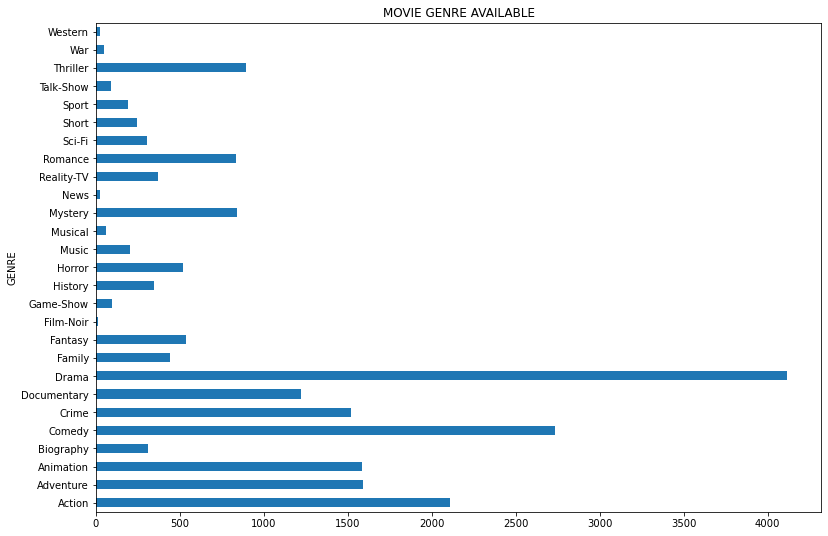

In [ ]:
df.iloc[:, 7:].sum().plot.barh(xlabel="GENRE", ylabel="Total",figsize=(13,9), title = "MOVIE GENRE AVAILABLE")

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

In [ ]:
yearmov=df["YEAR"]

In [ ]:
yearmov[0]

'(2021)'

In [ ]:
yearmov[36]

'(I) (2018– )'

In [ ]:
yearmov[878]

'Unknown'

In [ ]:
yearmov2 = []
for i in range(len(yearmov)):
    yearmov2.append(yearmov[i][1:5])
    print(i, yearmov2)

0 ['2021']
1 ['2021', '2021']
2 ['2021', '2021', '2010']
3 ['2021', '2021', '2010', '2013']
4 ['2021', '2021', '2010', '2013', '2021']
5 ['2021', '2021', '2010', '2013', '2021', '2020']
6 ['2021', '2021', '2010', '2013', '2021', '2020', '2021']
7 ['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006']
8 ['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020']
9 ['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020', '2019']
10 ['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020', '2019', '2021']
11 ['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020', '2019', '2021', '2016']
12 ['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020', '2019', '2021', '2016', '2021']
13 ['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020', '2019', '2021', '2016', '2021', '2021']
14 ['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020', '2019', '2021', '2016', '2021', '2021'

168 ['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020', '2019', '2021', '2016', '2021', '2021', '2011', '2005', '2008', '2017', '2017', '2016', '2021', '1994', '2014', '2013', '2021', '2021', '2013', '2015', '2005', '2013', '2021', '2016', '2013', '2003', '2019', '2009', 'I) (', '2019', '2010', '2013', '2011', '2017', '2015', '2014', '2015', '2011', '2017', '2016', '2021', '2021', '2014', '2005', '2009', '2008', '2016', '2009', '2020', '2019', '2018', '2017', '2020', '2016', '1987', '2021', '2021', '2019', '2015', '2018', '2012', '2014', '2011', '2005', '2019', '2021', '2021', '2021', '2021', '2017', '2007', '2018', '2000', '2021', '2021', '2021', 'II) ', '1993', '1999', '2015', '2017', '2016', '2018', '2019', '2014', '2016', '2013', '2016', '2021', '2012', '2013', '2007', '2020', '2018', '2011', '2017', '2010', '2021', '2016', '2000', '2019', '2015', '2014', '2001', '2019', '1997', '2011', '2017', '2011', '2014', '1993', '1989', '2010', '2010', '2015', '2017', '20

456 ['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020', '2019', '2021', '2016', '2021', '2021', '2011', '2005', '2008', '2017', '2017', '2016', '2021', '1994', '2014', '2013', '2021', '2021', '2013', '2015', '2005', '2013', '2021', '2016', '2013', '2003', '2019', '2009', 'I) (', '2019', '2010', '2013', '2011', '2017', '2015', '2014', '2015', '2011', '2017', '2016', '2021', '2021', '2014', '2005', '2009', '2008', '2016', '2009', '2020', '2019', '2018', '2017', '2020', '2016', '1987', '2021', '2021', '2019', '2015', '2018', '2012', '2014', '2011', '2005', '2019', '2021', '2021', '2021', '2021', '2017', '2007', '2018', '2000', '2021', '2021', '2021', 'II) ', '1993', '1999', '2015', '2017', '2016', '2018', '2019', '2014', '2016', '2013', '2016', '2021', '2012', '2013', '2007', '2020', '2018', '2011', '2017', '2010', '2021', '2016', '2000', '2019', '2015', '2014', '2001', '2019', '1997', '2011', '2017', '2011', '2014', '1993', '1989', '2010', '2010', '2015', '2017', '20

557 ['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020', '2019', '2021', '2016', '2021', '2021', '2011', '2005', '2008', '2017', '2017', '2016', '2021', '1994', '2014', '2013', '2021', '2021', '2013', '2015', '2005', '2013', '2021', '2016', '2013', '2003', '2019', '2009', 'I) (', '2019', '2010', '2013', '2011', '2017', '2015', '2014', '2015', '2011', '2017', '2016', '2021', '2021', '2014', '2005', '2009', '2008', '2016', '2009', '2020', '2019', '2018', '2017', '2020', '2016', '1987', '2021', '2021', '2019', '2015', '2018', '2012', '2014', '2011', '2005', '2019', '2021', '2021', '2021', '2021', '2017', '2007', '2018', '2000', '2021', '2021', '2021', 'II) ', '1993', '1999', '2015', '2017', '2016', '2018', '2019', '2014', '2016', '2013', '2016', '2021', '2012', '2013', '2007', '2020', '2018', '2011', '2017', '2010', '2021', '2016', '2000', '2019', '2015', '2014', '2001', '2019', '1997', '2011', '2017', '2011', '2014', '1993', '1989', '2010', '2010', '2015', '2017', '20

652 ['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020', '2019', '2021', '2016', '2021', '2021', '2011', '2005', '2008', '2017', '2017', '2016', '2021', '1994', '2014', '2013', '2021', '2021', '2013', '2015', '2005', '2013', '2021', '2016', '2013', '2003', '2019', '2009', 'I) (', '2019', '2010', '2013', '2011', '2017', '2015', '2014', '2015', '2011', '2017', '2016', '2021', '2021', '2014', '2005', '2009', '2008', '2016', '2009', '2020', '2019', '2018', '2017', '2020', '2016', '1987', '2021', '2021', '2019', '2015', '2018', '2012', '2014', '2011', '2005', '2019', '2021', '2021', '2021', '2021', '2017', '2007', '2018', '2000', '2021', '2021', '2021', 'II) ', '1993', '1999', '2015', '2017', '2016', '2018', '2019', '2014', '2016', '2013', '2016', '2021', '2012', '2013', '2007', '2020', '2018', '2011', '2017', '2010', '2021', '2016', '2000', '2019', '2015', '2014', '2001', '2019', '1997', '2011', '2017', '2011', '2014', '1993', '1989', '2010', '2010', '2015', '2017', '20

705 ['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020', '2019', '2021', '2016', '2021', '2021', '2011', '2005', '2008', '2017', '2017', '2016', '2021', '1994', '2014', '2013', '2021', '2021', '2013', '2015', '2005', '2013', '2021', '2016', '2013', '2003', '2019', '2009', 'I) (', '2019', '2010', '2013', '2011', '2017', '2015', '2014', '2015', '2011', '2017', '2016', '2021', '2021', '2014', '2005', '2009', '2008', '2016', '2009', '2020', '2019', '2018', '2017', '2020', '2016', '1987', '2021', '2021', '2019', '2015', '2018', '2012', '2014', '2011', '2005', '2019', '2021', '2021', '2021', '2021', '2017', '2007', '2018', '2000', '2021', '2021', '2021', 'II) ', '1993', '1999', '2015', '2017', '2016', '2018', '2019', '2014', '2016', '2013', '2016', '2021', '2012', '2013', '2007', '2020', '2018', '2011', '2017', '2010', '2021', '2016', '2000', '2019', '2015', '2014', '2001', '2019', '1997', '2011', '2017', '2011', '2014', '1993', '1989', '2010', '2010', '2015', '2017', '20

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



 ['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020', '2019', '2021', '2016', '2021', '2021', '2011', '2005', '2008', '2017', '2017', '2016', '2021', '1994', '2014', '2013', '2021', '2021', '2013', '2015', '2005', '2013', '2021', '2016', '2013', '2003', '2019', '2009', 'I) (', '2019', '2010', '2013', '2011', '2017', '2015', '2014', '2015', '2011', '2017', '2016', '2021', '2021', '2014', '2005', '2009', '2008', '2016', '2009', '2020', '2019', '2018', '2017', '2020', '2016', '1987', '2021', '2021', '2019', '2015', '2018', '2012', '2014', '2011', '2005', '2019', '2021', '2021', '2021', '2021', '2017', '2007', '2018', '2000', '2021', '2021', '2021', 'II) ', '1993', '1999', '2015', '2017', '2016', '2018', '2019', '2014', '2016', '2013', '2016', '2021', '2012', '2013', '2007', '2020', '2018', '2011', '2017', '2010', '2021', '2016', '2000', '2019', '2015', '2014', '2001', '2019', '1997', '2011', '2017', '2011', '2014', '1993', '1989', '2010', '2010', '2015', '2017', '2003'

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020', '2019', '2021', '2016', '2021', '2021', '2011', '2005', '2008', '2017', '2017', '2016', '2021', '1994', '2014', '2013', '2021', '2021', '2013', '2015', '2005', '2013', '2021', '2016', '2013', '2003', '2019', '2009', 'I) (', '2019', '2010', '2013', '2011', '2017', '2015', '2014', '2015', '2011', '2017', '2016', '2021', '2021', '2014', '2005', '2009', '2008', '2016', '2009', '2020', '2019', '2018', '2017', '2020', '2016', '1987', '2021', '2021', '2019', '2015', '2018', '2012', '2014', '2011', '2005', '2019', '2021', '2021', '2021', '2021', '2017', '2007', '2018', '2000', '2021', '2021', '2021', 'II) ', '1993', '1999', '2015', '2017', '2016', '2018', '2019', '2014', '2016', '2013', '2016', '2021', '2012', '2013', '2007', '2020', '2018', '2011', '2017', '2010', '2021', '2016', '2000', '2019', '2015', '2014', '2001', '2019', '1997', '2011', '2017', '2011', '2014', '1993', '1989', '2010', '2010', '2015', '2017', '2003',

2208 ['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020', '2019', '2021', '2016', '2021', '2021', '2011', '2005', '2008', '2017', '2017', '2016', '2021', '1994', '2014', '2013', '2021', '2021', '2013', '2015', '2005', '2013', '2021', '2016', '2013', '2003', '2019', '2009', 'I) (', '2019', '2010', '2013', '2011', '2017', '2015', '2014', '2015', '2011', '2017', '2016', '2021', '2021', '2014', '2005', '2009', '2008', '2016', '2009', '2020', '2019', '2018', '2017', '2020', '2016', '1987', '2021', '2021', '2019', '2015', '2018', '2012', '2014', '2011', '2005', '2019', '2021', '2021', '2021', '2021', '2017', '2007', '2018', '2000', '2021', '2021', '2021', 'II) ', '1993', '1999', '2015', '2017', '2016', '2018', '2019', '2014', '2016', '2013', '2016', '2021', '2012', '2013', '2007', '2020', '2018', '2011', '2017', '2010', '2021', '2016', '2000', '2019', '2015', '2014', '2001', '2019', '1997', '2011', '2017', '2011', '2014', '1993', '1989', '2010', '2010', '2015', '2017', '2

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




2783 ['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020', '2019', '2021', '2016', '2021', '2021', '2011', '2005', '2008', '2017', '2017', '2016', '2021', '1994', '2014', '2013', '2021', '2021', '2013', '2015', '2005', '2013', '2021', '2016', '2013', '2003', '2019', '2009', 'I) (', '2019', '2010', '2013', '2011', '2017', '2015', '2014', '2015', '2011', '2017', '2016', '2021', '2021', '2014', '2005', '2009', '2008', '2016', '2009', '2020', '2019', '2018', '2017', '2020', '2016', '1987', '2021', '2021', '2019', '2015', '2018', '2012', '2014', '2011', '2005', '2019', '2021', '2021', '2021', '2021', '2017', '2007', '2018', '2000', '2021', '2021', '2021', 'II) ', '1993', '1999', '2015', '2017', '2016', '2018', '2019', '2014', '2016', '2013', '2016', '2021', '2012', '2013', '2007', '2020', '2018', '2011', '2017', '2010', '2021', '2016', '2000', '2019', '2015', '2014', '2001', '2019', '1997', '2011', '2017', '2011', '2014', '1993', '1989', '2010', '2010', '2015', '2017', '

2834 ['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020', '2019', '2021', '2016', '2021', '2021', '2011', '2005', '2008', '2017', '2017', '2016', '2021', '1994', '2014', '2013', '2021', '2021', '2013', '2015', '2005', '2013', '2021', '2016', '2013', '2003', '2019', '2009', 'I) (', '2019', '2010', '2013', '2011', '2017', '2015', '2014', '2015', '2011', '2017', '2016', '2021', '2021', '2014', '2005', '2009', '2008', '2016', '2009', '2020', '2019', '2018', '2017', '2020', '2016', '1987', '2021', '2021', '2019', '2015', '2018', '2012', '2014', '2011', '2005', '2019', '2021', '2021', '2021', '2021', '2017', '2007', '2018', '2000', '2021', '2021', '2021', 'II) ', '1993', '1999', '2015', '2017', '2016', '2018', '2019', '2014', '2016', '2013', '2016', '2021', '2012', '2013', '2007', '2020', '2018', '2011', '2017', '2010', '2021', '2016', '2000', '2019', '2015', '2014', '2001', '2019', '1997', '2011', '2017', '2011', '2014', '1993', '1989', '2010', '2010', '2015', '2017', '2

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




3359 ['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020', '2019', '2021', '2016', '2021', '2021', '2011', '2005', '2008', '2017', '2017', '2016', '2021', '1994', '2014', '2013', '2021', '2021', '2013', '2015', '2005', '2013', '2021', '2016', '2013', '2003', '2019', '2009', 'I) (', '2019', '2010', '2013', '2011', '2017', '2015', '2014', '2015', '2011', '2017', '2016', '2021', '2021', '2014', '2005', '2009', '2008', '2016', '2009', '2020', '2019', '2018', '2017', '2020', '2016', '1987', '2021', '2021', '2019', '2015', '2018', '2012', '2014', '2011', '2005', '2019', '2021', '2021', '2021', '2021', '2017', '2007', '2018', '2000', '2021', '2021', '2021', 'II) ', '1993', '1999', '2015', '2017', '2016', '2018', '2019', '2014', '2016', '2013', '2016', '2021', '2012', '2013', '2007', '2020', '2018', '2011', '2017', '2010', '2021', '2016', '2000', '2019', '2015', '2014', '2001', '2019', '1997', '2011', '2017', '2011', '2014', '1993', '1989', '2010', '2010', '2015', '2017', '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020', '2019', '2021', '2016', '2021', '2021', '2011', '2005', '2008', '2017', '2017', '2016', '2021', '1994', '2014', '2013', '2021', '2021', '2013', '2015', '2005', '2013', '2021', '2016', '2013', '2003', '2019', '2009', 'I) (', '2019', '2010', '2013', '2011', '2017', '2015', '2014', '2015', '2011', '2017', '2016', '2021', '2021', '2014', '2005', '2009', '2008', '2016', '2009', '2020', '2019', '2018', '2017', '2020', '2016', '1987', '2021', '2021', '2019', '2015', '2018', '2012', '2014', '2011', '2005', '2019', '2021', '2021', '2021', '2021', '2017', '2007', '2018', '2000', '2021', '2021', '2021', 'II) ', '1993', '1999', '2015', '2017', '2016', '2018', '2019', '2014', '2016', '2013', '2016', '2021', '2012', '2013', '2007', '2020', '2018', '2011', '2017', '2010', '2021', '2016', '2000', '2019', '2015', '2014', '2001', '2019', '1997', '2011', '2017', '2011', '2014', '1993', '1989', '2010', '2010', '2015', '2017', '2003',

3864 ['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020', '2019', '2021', '2016', '2021', '2021', '2011', '2005', '2008', '2017', '2017', '2016', '2021', '1994', '2014', '2013', '2021', '2021', '2013', '2015', '2005', '2013', '2021', '2016', '2013', '2003', '2019', '2009', 'I) (', '2019', '2010', '2013', '2011', '2017', '2015', '2014', '2015', '2011', '2017', '2016', '2021', '2021', '2014', '2005', '2009', '2008', '2016', '2009', '2020', '2019', '2018', '2017', '2020', '2016', '1987', '2021', '2021', '2019', '2015', '2018', '2012', '2014', '2011', '2005', '2019', '2021', '2021', '2021', '2021', '2017', '2007', '2018', '2000', '2021', '2021', '2021', 'II) ', '1993', '1999', '2015', '2017', '2016', '2018', '2019', '2014', '2016', '2013', '2016', '2021', '2012', '2013', '2007', '2020', '2018', '2011', '2017', '2010', '2021', '2016', '2000', '2019', '2015', '2014', '2001', '2019', '1997', '2011', '2017', '2011', '2014', '1993', '1989', '2010', '2010', '2015', '2017', '2

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




4139 ['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020', '2019', '2021', '2016', '2021', '2021', '2011', '2005', '2008', '2017', '2017', '2016', '2021', '1994', '2014', '2013', '2021', '2021', '2013', '2015', '2005', '2013', '2021', '2016', '2013', '2003', '2019', '2009', 'I) (', '2019', '2010', '2013', '2011', '2017', '2015', '2014', '2015', '2011', '2017', '2016', '2021', '2021', '2014', '2005', '2009', '2008', '2016', '2009', '2020', '2019', '2018', '2017', '2020', '2016', '1987', '2021', '2021', '2019', '2015', '2018', '2012', '2014', '2011', '2005', '2019', '2021', '2021', '2021', '2021', '2017', '2007', '2018', '2000', '2021', '2021', '2021', 'II) ', '1993', '1999', '2015', '2017', '2016', '2018', '2019', '2014', '2016', '2013', '2016', '2021', '2012', '2013', '2007', '2020', '2018', '2011', '2017', '2010', '2021', '2016', '2000', '2019', '2015', '2014', '2001', '2019', '1997', '2011', '2017', '2011', '2014', '1993', '1989', '2010', '2010', '2015', '2017', '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




4514 ['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020', '2019', '2021', '2016', '2021', '2021', '2011', '2005', '2008', '2017', '2017', '2016', '2021', '1994', '2014', '2013', '2021', '2021', '2013', '2015', '2005', '2013', '2021', '2016', '2013', '2003', '2019', '2009', 'I) (', '2019', '2010', '2013', '2011', '2017', '2015', '2014', '2015', '2011', '2017', '2016', '2021', '2021', '2014', '2005', '2009', '2008', '2016', '2009', '2020', '2019', '2018', '2017', '2020', '2016', '1987', '2021', '2021', '2019', '2015', '2018', '2012', '2014', '2011', '2005', '2019', '2021', '2021', '2021', '2021', '2017', '2007', '2018', '2000', '2021', '2021', '2021', 'II) ', '1993', '1999', '2015', '2017', '2016', '2018', '2019', '2014', '2016', '2013', '2016', '2021', '2012', '2013', '2007', '2020', '2018', '2011', '2017', '2010', '2021', '2016', '2000', '2019', '2015', '2014', '2001', '2019', '1997', '2011', '2017', '2011', '2014', '1993', '1989', '2010', '2010', '2015', '2017', '

4568 ['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020', '2019', '2021', '2016', '2021', '2021', '2011', '2005', '2008', '2017', '2017', '2016', '2021', '1994', '2014', '2013', '2021', '2021', '2013', '2015', '2005', '2013', '2021', '2016', '2013', '2003', '2019', '2009', 'I) (', '2019', '2010', '2013', '2011', '2017', '2015', '2014', '2015', '2011', '2017', '2016', '2021', '2021', '2014', '2005', '2009', '2008', '2016', '2009', '2020', '2019', '2018', '2017', '2020', '2016', '1987', '2021', '2021', '2019', '2015', '2018', '2012', '2014', '2011', '2005', '2019', '2021', '2021', '2021', '2021', '2017', '2007', '2018', '2000', '2021', '2021', '2021', 'II) ', '1993', '1999', '2015', '2017', '2016', '2018', '2019', '2014', '2016', '2013', '2016', '2021', '2012', '2013', '2007', '2020', '2018', '2011', '2017', '2010', '2021', '2016', '2000', '2019', '2015', '2014', '2001', '2019', '1997', '2011', '2017', '2011', '2014', '1993', '1989', '2010', '2010', '2015', '2017', '2

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020', '2019', '2021', '2016', '2021', '2021', '2011', '2005', '2008', '2017', '2017', '2016', '2021', '1994', '2014', '2013', '2021', '2021', '2013', '2015', '2005', '2013', '2021', '2016', '2013', '2003', '2019', '2009', 'I) (', '2019', '2010', '2013', '2011', '2017', '2015', '2014', '2015', '2011', '2017', '2016', '2021', '2021', '2014', '2005', '2009', '2008', '2016', '2009', '2020', '2019', '2018', '2017', '2020', '2016', '1987', '2021', '2021', '2019', '2015', '2018', '2012', '2014', '2011', '2005', '2019', '2021', '2021', '2021', '2021', '2017', '2007', '2018', '2000', '2021', '2021', '2021', 'II) ', '1993', '1999', '2015', '2017', '2016', '2018', '2019', '2014', '2016', '2013', '2016', '2021', '2012', '2013', '2007', '2020', '2018', '2011', '2017', '2010', '2021', '2016', '2000', '2019', '2015', '2014', '2001', '2019', '1997', '2011', '2017', '2011', '2014', '1993', '1989', '2010', '2010', '2015', '2017', '2003',

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




8980 ['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020', '2019', '2021', '2016', '2021', '2021', '2011', '2005', '2008', '2017', '2017', '2016', '2021', '1994', '2014', '2013', '2021', '2021', '2013', '2015', '2005', '2013', '2021', '2016', '2013', '2003', '2019', '2009', 'I) (', '2019', '2010', '2013', '2011', '2017', '2015', '2014', '2015', '2011', '2017', '2016', '2021', '2021', '2014', '2005', '2009', '2008', '2016', '2009', '2020', '2019', '2018', '2017', '2020', '2016', '1987', '2021', '2021', '2019', '2015', '2018', '2012', '2014', '2011', '2005', '2019', '2021', '2021', '2021', '2021', '2017', '2007', '2018', '2000', '2021', '2021', '2021', 'II) ', '1993', '1999', '2015', '2017', '2016', '2018', '2019', '2014', '2016', '2013', '2016', '2021', '2012', '2013', '2007', '2020', '2018', '2011', '2017', '2010', '2021', '2016', '2000', '2019', '2015', '2014', '2001', '2019', '1997', '2011', '2017', '2011', '2014', '1993', '1989', '2010', '2010', '2015', '2017', '

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




9459 ['2021', '2021', '2010', '2013', '2021', '2020', '2021', '2006', '2020', '2019', '2021', '2016', '2021', '2021', '2011', '2005', '2008', '2017', '2017', '2016', '2021', '1994', '2014', '2013', '2021', '2021', '2013', '2015', '2005', '2013', '2021', '2016', '2013', '2003', '2019', '2009', 'I) (', '2019', '2010', '2013', '2011', '2017', '2015', '2014', '2015', '2011', '2017', '2016', '2021', '2021', '2014', '2005', '2009', '2008', '2016', '2009', '2020', '2019', '2018', '2017', '2020', '2016', '1987', '2021', '2021', '2019', '2015', '2018', '2012', '2014', '2011', '2005', '2019', '2021', '2021', '2021', '2021', '2017', '2007', '2018', '2000', '2021', '2021', '2021', 'II) ', '1993', '1999', '2015', '2017', '2016', '2018', '2019', '2014', '2016', '2013', '2016', '2021', '2012', '2013', '2007', '2020', '2018', '2011', '2017', '2010', '2021', '2016', '2000', '2019', '2015', '2014', '2001', '2019', '1997', '2011', '2017', '2011', '2014', '1993', '1989', '2010', '2010', '2015', '2017', '

In [ ]:
print(yearmov)

0            (2021)
1          (2021– )
2       (2010–2022)
3          (2013– )
4            (2021)
           ...     
9485       (2022– )
9486       (2021– )
9487       (2022– )
9488       (2021– )
9489       (2021– )
Name: YEAR, Length: 9490, dtype: object


In [ ]:
import re
re.findall(r'^\d',yearmov[9000])

[]

In [ ]:
me = re.findall("\d+", yearmov[9000])[0]
print(me)

2021


In [ ]:
from more_itertools import one
yearmov2 = []
for j in range(len(yearmov)):
    me = re.findall("\d+", yearmov[j])
    if len(me)>1:
        yearmov2.append(me[0])
    elif len(me)==0:
        yearmov2.append("0")
    else:
        yearmov2.append(one(me))

In [ ]:
movies.dtypes

MOVIES       object
YEAR         object
GENRE        object
RATING      float64
ONE-LINE     object
STARS        object
VOTES        object
RunTime     float64
dtype: object

In [ ]:
movies.head()

,MOVIES,YEAR,GENRE,RATING,ONE-LINE,STARS,VOTES,RunTime
0,Blood Red Sky,2021,"[Action, Horror, Thriller]",6.1,A woman with a mysterious illness is forced in...,Director:Peter Thorwarth| Stars:Peri B...,"21,062",121.0
1,Masters of the Universe: Revelation,2021,"[Animation, Action, Adventure]",5.0,The war for Eternia begins again in what may b...,"Stars:Chris Wood, Sarah Michel...","17,870",25.0
2,The Walking Dead,2010,"[Drama, Horror, Thriller]",8.2,Sheriff Deputy Rick Grimes wakes up from a com...,"Stars:Andrew Lincoln, Norman R...","885,805",44.0
3,Rick and Morty,2013,"[Animation, Adventure, Comedy]",9.2,An animated series that follows the exploits o...,"Stars:Justin Roiland, Chris Pa...","414,849",23.0
4,Army of Thieves,2021,"[Action, Crime, Horror]",0.0,"A prequel, set before the events of Army of th...",Director:Matthias Schweighöfer| Stars:...,0,0.0


In [ ]:
movies['YEAR'] = movies['YEAR'].astype(str).astype(int)

In [ ]:
movies.dtypes

MOVIES       object
YEAR          int32
GENRE        object
RATING      float64
ONE-LINE     object
STARS        object
VOTES        object
RunTime     float64
dtype: object

In [ ]:
df["YEAR"] = yearmov2

In [ ]:
df.head()

,MOVIES,YEAR,RATING,ONE-LINE,STARS,VOTES,RunTime,Action,Adventure,Animation,...,News,Reality-TV,Romance,Sci-Fi,Short,Sport,Talk-Show,Thriller,War,Western
0,Blood Red Sky,2021,6.1,A woman with a mysterious illness is forced in...,Director:Peter Thorwarth| Stars:Peri B...,"21,062",121.0,1,0,0,...,0,0,0,0,0,0,0,1,0,0
1,Masters of the Universe: Revelation,2021,5.0,The war for Eternia begins again in what may b...,"Stars:Chris Wood, Sarah Michel...","17,870",25.0,1,1,1,...,0,0,0,0,0,0,0,0,0,0
2,The Walking Dead,2010,8.2,Sheriff Deputy Rick Grimes wakes up from a com...,"Stars:Andrew Lincoln, Norman R...","885,805",44.0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
3,Rick and Morty,2013,9.2,An animated series that follows the exploits o...,"Stars:Justin Roiland, Chris Pa...","414,849",23.0,0,1,1,...,0,0,0,0,0,0,0,0,0,0
4,Army of Thieves,2021,0.0,"A prequel, set before the events of Army of th...",Director:Matthias Schweighöfer| Stars:...,0,0.0,1,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
df["YEAR"] = df["YEAR"].astype(str).astype(int)

In [ ]:
df.head()

,MOVIES,YEAR,RATING,ONE-LINE,STARS,VOTES,RunTime,Action,Adventure,Animation,...,News,Reality-TV,Romance,Sci-Fi,Short,Sport,Talk-Show,Thriller,War,Western
0,Blood Red Sky,2021,6.1,A woman with a mysterious illness is forced in...,Director:Peter Thorwarth| Stars:Peri B...,"21,062",121.0,1,0,0,...,0,0,0,0,0,0,0,1,0,0
1,Masters of the Universe: Revelation,2021,5.0,The war for Eternia begins again in what may b...,"Stars:Chris Wood, Sarah Michel...","17,870",25.0,1,1,1,...,0,0,0,0,0,0,0,0,0,0
2,The Walking Dead,2010,8.2,Sheriff Deputy Rick Grimes wakes up from a com...,"Stars:Andrew Lincoln, Norman R...","885,805",44.0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
3,Rick and Morty,2013,9.2,An animated series that follows the exploits o...,"Stars:Justin Roiland, Chris Pa...","414,849",23.0,0,1,1,...,0,0,0,0,0,0,0,0,0,0
4,Army of Thieves,2021,0.0,"A prequel, set before the events of Army of th...",Director:Matthias Schweighöfer| Stars:...,0,0.0,1,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
df.dtypes

MOVIES                   object
YEAR                      int32
RATING                  float64
ONE-LINE                 object
STARS                    object
VOTES                    object
RunTime                 float64
Action         Sparse[int32, 0]
Adventure      Sparse[int32, 0]
Animation      Sparse[int32, 0]
Biography      Sparse[int32, 0]
Comedy         Sparse[int32, 0]
Crime          Sparse[int32, 0]
Documentary    Sparse[int32, 0]
Drama          Sparse[int32, 0]
Family         Sparse[int32, 0]
Fantasy        Sparse[int32, 0]
Film-Noir      Sparse[int32, 0]
Game-Show      Sparse[int32, 0]
History        Sparse[int32, 0]
Horror         Sparse[int32, 0]
Music          Sparse[int32, 0]
Musical        Sparse[int32, 0]
Mystery        Sparse[int32, 0]
News           Sparse[int32, 0]
Reality-TV     Sparse[int32, 0]
Romance        Sparse[int32, 0]
Sci-Fi         Sparse[int32, 0]
Short          Sparse[int32, 0]
Sport          Sparse[int32, 0]
Talk-Show      Sparse[int32, 0]
Thriller

# Get Insights

In [ ]:
movies.sort_values(by = "YEAR", ascending=False)

,MOVIES,YEAR,GENRE,RATING,ONE-LINE,STARS,VOTES,RunTime
9273,Astérix,2023,"[Animation, Action, Adventure]",0.0,Add a Plot,,0,0.0
3313,The Monkey King,2023,"[Animation, Action, Adventure]",0.0,An animated version of the mythical Chinese hero.,Director:Anthony Stacchi| Stars:BD Won...,0,0.0
1944,The Mother,2022,"[Action, Thriller]",0.0,Female-led action thriller.,Director:Niki Caro| Star:Jennifer Lopez,0,0.0
4854,Hiyama Kentarô no ninshin,2022,"[Comedy, Drama, Romance]",0.0,The story takes place in a world where-in rare...,"Stars:Takumi Saitoh, Juri Ueno",0,0.0
5123,Bulbul Tarang,2022,"[Comedy, Drama, Romance]",0.0,A bride tries to fight against the rules once ...,Director:Shree Narayan Singh| Stars:So...,0,0.0
...,...,...,...,...,...,...,...,...
3854,The Formula,0,"[Crime, Drama, Sport]",0.0,Follow a Formula One racing prodigy who is for...,Director:Gerard McMurray| Stars:Robert...,0,0.0
3833,Family Leave,0,[Comedy],0.0,The Brenners wake up to a full family body swi...,Star:Jennifer Garner,0,0.0
3800,Carmen Sandiego,0,"[Action, Adventure, Family]",0.0,A live-action feature film based on Carmen San...,Star:Gina Rodriguez,0,0.0
3774,The Chronicles of Narnia: The Magician's Nephew,0,"[Action, Adventure, Fantasy]",0.0,"The next installment of C.S. Lewis's ""Chronicl...",,0,0.0


In [ ]:
print(movies.sort_values(by = "YEAR", ascending=False).groupby("YEAR").mean()["RATING"])

YEAR
0       0.000000
1932    6.550000
1933    5.400000
1938    5.200000
1941    7.200000
          ...   
2019    6.836562
2020    6.303232
2021    4.833978
2022    0.000000
2023    0.000000
Name: RATING, Length: 79, dtype: float64


In [ ]:
df.loc[df["YEAR"] == 2000]

,MOVIES,YEAR,RATING,ONE-LINE,STARS,VOTES,RunTime,Action,Adventure,Animation,...,News,Reality-TV,Romance,Sci-Fi,Short,Sport,Talk-Show,Thriller,War,Western
80,Gilmore Girls,2000,8.1,A dramedy centering around the relationship be...,"Stars:Lauren Graham, Alexis Bl...","106,650",44.0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
107,CSI: Crime Scene Investigation,2000,7.6,Series following an elite team of police foren...,"Stars:Laurence Fishburne, Marg...","78,589",60.0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
145,American Psycho,2000,7.6,A wealthy New York City investment banking exe...,Director:Mary Harron| Stars:Christian ...,"517,014",101.0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
616,The Emperor's New Groove,2000,7.4,Emperor Kuzco is turned into a llama by his ex...,Director:Mark Dindal| Stars:David Spad...,"187,523",78.0,0,1,1,...,0,0,0,0,0,0,0,0,0,0
1131,Inuyasha,2000,7.9,A teenage girl periodically travels back in ti...,"Stars:Kappei Yamaguchi, Richar...","15,149",24.0,1,1,1,...,0,0,0,0,0,0,0,0,0,0
2204,Power Rangers Megaforce,2000,5.7,An evil galactic armada has come to destroy th...,"Stars:Andrew Gray, Ciara Hanna...","1,495",24.0,1,1,0,...,0,0,0,0,0,0,0,0,0,0
3345,Paranoid,2000,4.0,"A fashion model, living in London, attends a d...",Director:John Duigan| Stars:Jessica Al...,"2,253",93.0,0,0,0,...,0,0,0,0,0,0,0,1,0,0
3988,Petualangan Sherina,2000,7.8,Adventure of a little girl who just moved to a...,Director:Riri Riza| Stars:Sherina Muna...,756,112.0,0,1,0,...,0,0,0,0,0,0,0,0,0,0
6275,Graffiti Verité 3: A Voyage Into the Iconograp...,2000,0.0,This experimental musical opus probes the soci...,"Director:Bob Bryan| Stars:Bruin, Chaz,...",0,54.0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
6305,Magic 4 Morons,2000,0.0,Magic 4 Morons teaches the viewer 10 amazing m...,Director:Rick Pamplin| Stars:Eric Mile...,0,60.0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


<AxesSubplot:title={'center':'AVERAGE OF MOVIE RATING FROM 2011-2021'}, xlabel='YEAR', ylabel='RATING'>

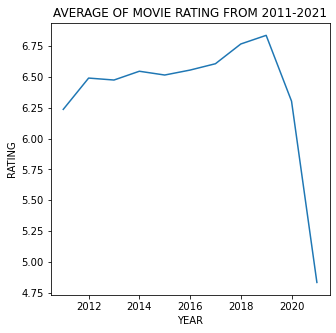

In [ ]:
df.loc[(df["YEAR"] >= 2011) & (df["YEAR"] <= 2021)].groupby("YEAR").mean()["RATING"].plot.line(ylabel="RATING",figsize=(5,5), title="AVERAGE OF MOVIE RATING FROM 2011-2021")

<AxesSubplot:title={'center':'AVERAGE OF MOVIE RATING FROM 2000-2010'}, xlabel='YEAR', ylabel='RATING'>

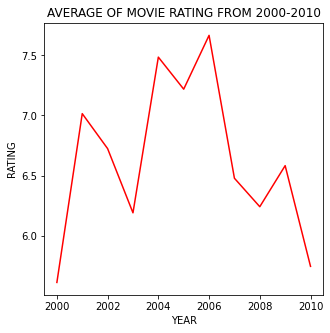

In [ ]:
df.loc[(df["YEAR"] >= 2000) & (df["YEAR"] <= 2010)].groupby("YEAR").mean()["RATING"].plot.line(ylabel="RATING",figsize=(5,5), color="red", title="AVERAGE OF MOVIE RATING FROM 2000-2010")

<AxesSubplot:title={'center':'AVERAGE OF MOVIE RATING FROM 1990-2000'}, xlabel='YEAR', ylabel='RATING'>

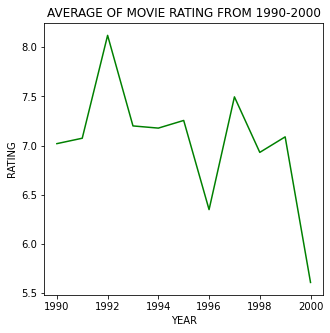

In [ ]:
df.loc[(df["YEAR"] >= 1990) & (df["YEAR"] <= 2000)].groupby("YEAR").mean()["RATING"].plot.line(ylabel="RATING",figsize=(5,5), color="green", title="AVERAGE OF MOVIE RATING FROM 1990-2000")

In [ ]:
!pip install --upgrade scipy

Requirement already up-to-date: scipy in c:\users\user\anaconda3\lib\site-packages (1.7.1)


In [ ]:
import pandas as pd
from scipy import stats
from statsmodels.stats import weightstats as stests
alpha = 0.05
mean_hipotesis = 7
# Default : Two Tailed
ztest , pval = stests.ztest(df.loc[(movies["YEAR"] >= 2011) & (movies["YEAR"] <= 2021)]["RATING"], movies.loc[(movies["YEAR"] >= 2000) & (df["YEAR"] <= 2010)]["RATING"], alternative = 'smaller')
print("H0: The mean of movie rating from 2011-2021 >= The mean of movie rating from 2000-2010")
print("H1: The mean of movie rating from 2011-2021 < The mean of movie rating from 2000-2010")
print("The alpha is ", alpha)
print("The p-value is ", float(pval))
if pval < alpha:
    print("H0 is rejected, therefore H1 is accepted")
else:
    print("H0 is accepted")

H0: The mean of movie rating from 2011-2021 >= The mean of movie rating from 2000-2010
H1: The mean of movie rating from 2011-2021 < The mean of movie rating from 2000-2010
The alpha is  0.05
The p-value is  4.3776506128224235e-09
H0 is rejected, therefore H1 is accepted


In [ ]:
df.loc[(df["YEAR"] >= 2011) & (df["YEAR"] <= 2021)]["RATING"]

0       6.1
1       5.0
3       9.2
4       0.0
5       7.6
       ... 
9483    0.0
9484    0.0
9486    0.0
9488    0.0
9489    0.0
Name: RATING, Length: 7845, dtype: float64

In [ ]:
import pandas as pd
from scipy import stats
from statsmodels.stats import weightstats as stests
alpha = 0.05
mean_hipotesis = 120
# Default : Two Tailed
ztest , pval = stests.ztest(df.loc[(df["YEAR"] >= 2011) & (df["YEAR"] <= 2021)]["RunTime"], value = mean_hipotesis, alternative = 'larger')
print("H0: The mean of movie RunTime from 2011-2021 <= 120 min")
print("H1: The mean of movie RunTime from 2011-2021 > 120 min")
print("The alpha is ", alpha)
print("The p-value is ", float(pval))
if pval < alpha:
    print("H0 is rejected, therefore H1 is accepted")
else:
    print("H0 is accepted")

H0: The mean of movie RunTime from 2011-2021 <= 120 min
H1: The mean of movie RunTime from 2011-2021 > 120 min
The alpha is  0.05
The p-value is  1.0
H0 is accepted


In [ ]:
import pandas as pd
from scipy import stats
from statsmodels.stats import weightstats as stests
alpha = 0.05
mean_hipotesis = 120
# Default : Two Tailed
ztest , pval = stests.ztest(df.loc[(df["YEAR"] >= 2000) & (df["YEAR"] <= 2010)]["RunTime"], value = mean_hipotesis, alternative = 'larger')
print("H0: The mean of movie RunTime from 2000-2010 <= 120 min")
print("H1: The mean of movie RunTime from 2000-2010 > 120 min")
print("The alpha is ", alpha)
print("The p-value is ", float(pval))
if pval < alpha:
    print("H0 is rejected, therefore H1 is accepted")
else:
    print("H0 is accepted")

H0: The mean of movie RunTime from 2000-2010 <= 120 min
H1: The mean of movie RunTime from 2000-2010 > 120 min
The alpha is  0.05
The p-value is  1.0
H0 is accepted


In [ ]:
import pandas as pd
from scipy import stats
from statsmodels.stats import weightstats as stests
alpha = 0.05
mean_hipotesis = 120
# Default : Two Tailed
ztest , pval = stests.ztest(df.loc[(df["YEAR"] >= 1900) & (df["YEAR"] <= 1990)]["RunTime"], value = mean_hipotesis, alternative = 'smaller')
print("H0: The mean of movie RunTime from 1900s-1990s >= 120 min")
print("H1: The mean of movie RunTime from 1900s-1990s < 120 min")
print("The alpha is ", alpha)
print("The p-value is ", float(pval))
if pval < alpha:
    print("H0 is rejected, therefore H1 is accepted")
else:
    print("H0 is accepted")

H0: The mean of movie RunTime from 1900s-1990s >= 120 min
H1: The mean of movie RunTime from 1900s-1990s < 120 min
The alpha is  0.05
The p-value is  4.5831009158792664e-15
H0 is rejected, therefore H1 is accepted


In [ ]:
print("Descriptive Statistics of column 'RATING'")
df["RATING"].describe()

Descriptive Statistics of column 'RATING'


count    9490.000000
mean        5.948145
std         2.657227
min         0.000000
25%         5.500000
50%         6.800000
75%         7.600000
max         9.900000
Name: RATING, dtype: float64

In [ ]:
print("Descriptive Statistics of column 'RunTime'")
df["RunTime"].describe()

Descriptive Statistics of column 'RunTime'


count    9490.000000
mean       50.781981
std        50.666680
min         0.000000
25%         0.000000
50%        43.000000
75%        87.000000
max       853.000000
Name: RunTime, dtype: float64

In [ ]:
df.iloc[:, 7:].sum()

Action         2110
Adventure      1588
Animation      1584
Biography       311
Comedy         2736
Crime          1519
Documentary    1221
Drama          4115
Family          442
Fantasy         537
Film-Noir        12
Game-Show        98
History         346
Horror          518
Music           200
Musical          61
Mystery         840
News             23
Reality-TV      370
Romance         835
Sci-Fi          303
Short           247
Sport           192
Talk-Show        89
Thriller        895
War              48
Western          24
dtype: int64

# Conclusion
* In brief, this “MOVIES DATASET FOR FEATURE EXTRACTION, PREDICTION” is very dirty in having missing values, duplicated data, and inconsistent datatype, especially in mixed datatype, such as number and string in a row of data. After some pre-processing, I have a cleaned and prepared dataset to be analysed in future projects in regression and classification. However, as I have found before, I have set the missing values as zero (“0”) values. In the future, they can be replaced by their true values for better analysis and prediction.

* Therefore, I hope that some additional data are required to replace that zero values can be added soon by extracting data from the available source (Netflix/IMDB).